In [1]:
import math
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import sklearn

import sklearn.preprocessing as scale
#import sklearn.model_selection as train_test_split
from sklearn.model_selection import train_test_split
import sklearn.metrics as mean_squared_error
from sklearn.metrics import mean_squared_error
import sklearn.metrics as r2_score
from sklearn.metrics import r2_score

#Modelos
from sklearn.linear_model import Ridge,RidgeCV
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline




In [2]:
#Setro pantalla para ver todas las columnas y filas

pd.set_option('display.max_columns',25)

CARGAR DATOS hitters.csv

In [3]:
df = pd.read_csv('F:/CAPACITACION/MODELO MLEARNING/CURSO DR ARRIGO/Hitters.csv')

In [4]:

from ydata_profiling import ProfileReport
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [4]:
#!pip install dtale
import dtale
import dtale.app as dtale_app

dtale_app.USE_COLAB = True


In [6]:
dtale.show(df,host='localhost')

In [6]:
df.head()

,AtBat,Hits,HmRun,Runs,RBI,Walks,Years,CAtBat,CHits,CHmRun,CRuns,CRBI,CWalks,League,Division,PutOuts,Assists,Errors,Salary,NewLeague
0,293,66,1,30,29,14,1,293,66,1,30,29,14,A,E,446,33,20,NaN,A
1,315,81,7,24,38,39,14,3449,835,69,321,414,375,N,W,632,43,10,475.0,N
2,479,130,18,66,72,76,3,1624,457,63,224,266,263,A,W,880,82,14,480.0,A
3,496,141,20,65,78,37,11,5628,1575,225,828,838,354,N,E,200,11,3,500.0,N
4,321,87,10,39,42,30,2,396,101,12,48,46,33,N,E,805,40,4,91.5,N


In [7]:
df.isnull().sum()

AtBat         0
Hits          0
HmRun         0
Runs          0
RBI           0
Walks         0
Years         0
CAtBat        0
CHits         0
CHmRun        0
CRuns         0
CRBI          0
CWalks        0
League        0
Division      0
PutOuts       0
Assists       0
Errors        0
Salary       59
NewLeague     0
dtype: int64

In [8]:

# Number of missing values in each column of training data
missing_val_count_by_column = (df.isnull().sum())
print(missing_val_count_by_column[missing_val_count_by_column > 0])

Salary    59
dtype: int64


In [9]:
#El salario es la variable a predecir.
df = df.dropna()

In [10]:
# Number of missing values in each column of training data
missing_val_count_by_column = (df.isnull().sum())
print(missing_val_count_by_column[missing_val_count_by_column > 0])


Series([], dtype: int64)


In [11]:
y = df['Salary']
X = df.drop(columns='Salary')

In [12]:
X.shape

(263, 19)

In [13]:
variables_categoricas = df.select_dtypes(include=['object']).columns.to_list()
  #                     df.select_dtypes(include=['object'])



In [14]:
variables_numericas = df.select_dtypes(exclude=['object']).columns.to_list()
  #                     df.select_dtypes(include=['object'])

In [15]:
variables_categoricas

['League', 'Division', 'NewLeague']

In [16]:
variables_numericas

['AtBat',
 'Hits',
 'HmRun',
 'Runs',
 'RBI',
 'Walks',
 'Years',
 'CAtBat',
 'CHits',
 'CHmRun',
 'CRuns',
 'CRBI',
 'CWalks',
 'PutOuts',
 'Assists',
 'Errors',
 'Salary']

OneHotEncoder/Dummies para las categoricas

In [17]:
dummies = pd.get_dummies(X[variables_categoricas], dtype=int)

In [18]:
#columnas_dummies = dummies.columns.to_list()
columnas_dummies = ['League_N', 'Division_W',  'NewLeague_N']
columnas_dummies

['League_N', 'Division_W', 'NewLeague_N']

In [19]:
X

,AtBat,Hits,HmRun,Runs,RBI,Walks,Years,CAtBat,CHits,CHmRun,CRuns,CRBI,CWalks,League,Division,PutOuts,Assists,Errors,NewLeague
1,315,81,7,24,38,39,14,3449,835,69,321,414,375,N,W,632,43,10,N
2,479,130,18,66,72,76,3,1624,457,63,224,266,263,A,W,880,82,14,A
3,496,141,20,65,78,37,11,5628,1575,225,828,838,354,N,E,200,11,3,N
4,321,87,10,39,42,30,2,396,101,12,48,46,33,N,E,805,40,4,N
5,594,169,4,74,51,35,11,4408,1133,19,501,336,194,A,W,282,421,25,A
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
317,497,127,7,65,48,37,5,2703,806,32,379,311,138,N,E,325,9,3,N
318,492,136,5,76,50,94,12,5511,1511,39,897,451,875,A,E,313,381,20,A
319,475,126,3,61,43,52,6,1700,433,7,217,93,146,A,W,37,113,7,A
320,573,144,9,85,60,78,8,3198,857,97,470,420,332,A,E,1314,131,12,A


In [20]:
X= X.drop(columns= variables_categoricas, axis = 1)
X = pd.concat([X,dummies[columnas_dummies]], axis= 1)
#X = X.drop(columns= ['League', 'Division',  'NewLeague'], axis = 1).astype('float64')

In [21]:
X

,AtBat,Hits,HmRun,Runs,RBI,Walks,Years,CAtBat,CHits,CHmRun,CRuns,CRBI,CWalks,PutOuts,Assists,Errors,League_N,Division_W,NewLeague_N
1,315,81,7,24,38,39,14,3449,835,69,321,414,375,632,43,10,1,1,1
2,479,130,18,66,72,76,3,1624,457,63,224,266,263,880,82,14,0,1,0
3,496,141,20,65,78,37,11,5628,1575,225,828,838,354,200,11,3,1,0,1
4,321,87,10,39,42,30,2,396,101,12,48,46,33,805,40,4,1,0,1
5,594,169,4,74,51,35,11,4408,1133,19,501,336,194,282,421,25,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
317,497,127,7,65,48,37,5,2703,806,32,379,311,138,325,9,3,1,0,1
318,492,136,5,76,50,94,12,5511,1511,39,897,451,875,313,381,20,0,0,0
319,475,126,3,61,43,52,6,1700,433,7,217,93,146,37,113,7,0,1,0
320,573,144,9,85,60,78,8,3198,857,97,470,420,332,1314,131,12,0,0,0


In [22]:
descrip = {
    'AtBat': 'Número de veces al bate en 1986.',
    'Hits': 'Número de hits en 1986.',
    'HmRun': 'Número de home runs en 1986.',
    'Runs': 'Número de carreras anotadas en 1986.',
    'RBI': 'Número de carreras impulsadas en 1986.',
    'Walks': 'Número de bases por bolas recibidas en 1986.',
    'Years': 'Número de años en las ligas mayores.',
    'CAtBat': 'Número de veces al bate durante su carrera.',
    'CHits': 'Número de hits durante su carrera.',
    'CHmRun': 'Número de home runs durante su carrera.',
    'CRuns': 'Número de carreras durante su carrera.',
    'CRBI': 'Número de carreras impulsadas durante su carrera.',
    'CWalks': 'Número de bases por bolas recibidas durante su carrera.',
    'PutOuts': 'Número de outs realizados en 1986.',
    'Assists': 'Número de asistencias en 1986.',
    'Errors': 'Número de errores en 1986.',
    'League_N': 'Liga del jugador al final de 1986. 0 = American League, 1 = National League',
    'Division_W': 'División del jugador al final de 1986. 0 = East, 1 = West',
    'NewLeague_N': 'Liga del jugador al principio de 1987. 0 = American League, 1 = National League'
}




C:\Users\victo\AppData\Local\Temp\ipykernel_3164\3884307551.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(y)
D:\Programas\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


Text(0.5, 0, 'Salario')

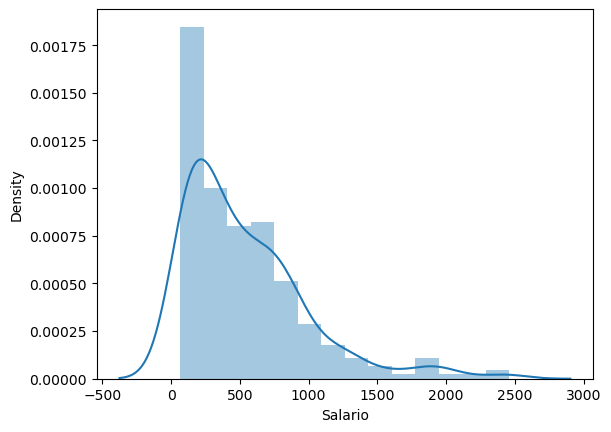

In [23]:
#VISUALIZACION DE LOS DATOS:
#
#Histograma de la frecuencia relativa del salrio con la densidad ajustada correspondiente.
sns.distplot(y)
plt.xlabel('Salario')


In [24]:
y.describe()

count     263.000000
mean      535.925882
std       451.118681
min        67.500000
25%       190.000000
50%       425.000000
75%       750.000000
max      2460.000000
Name: Salary, dtype: float64

Mínimo :  19
Máximo :  687


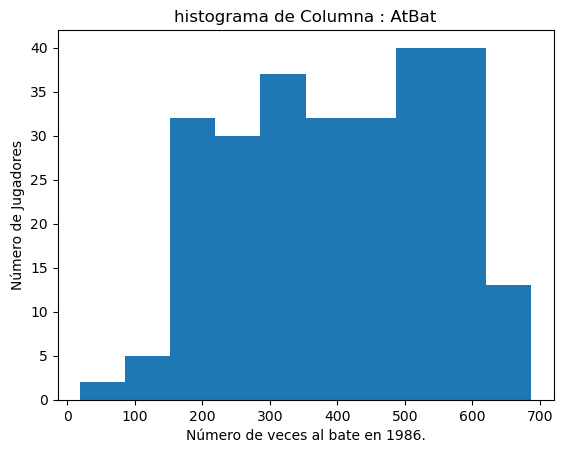

Mínimo :  1
Máximo :  238


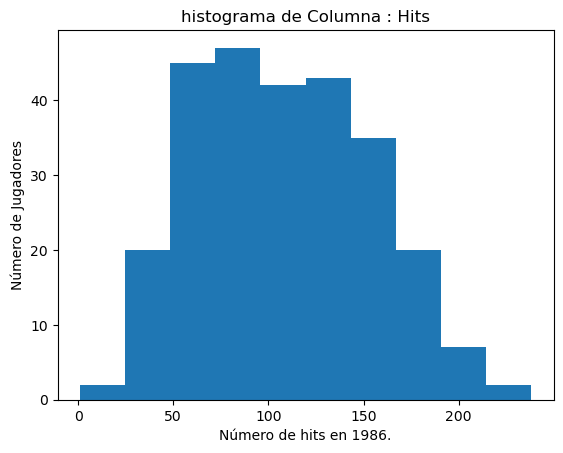

Mínimo :  0
Máximo :  40


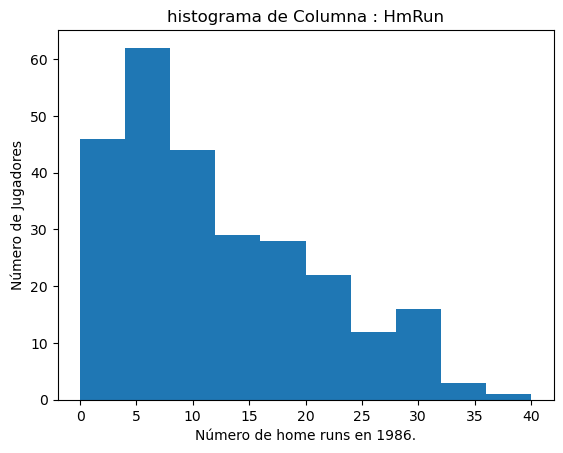

Mínimo :  0
Máximo :  130


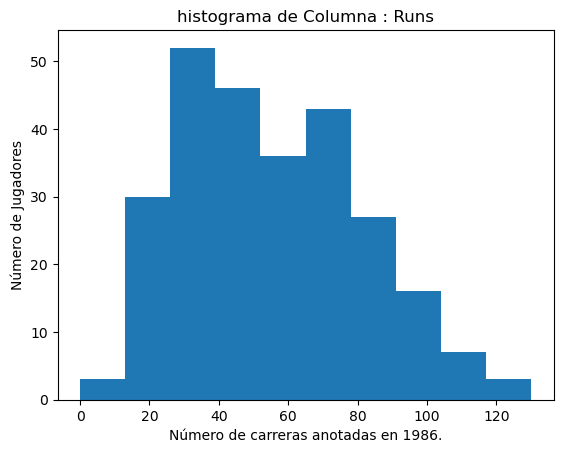

Mínimo :  0
Máximo :  121


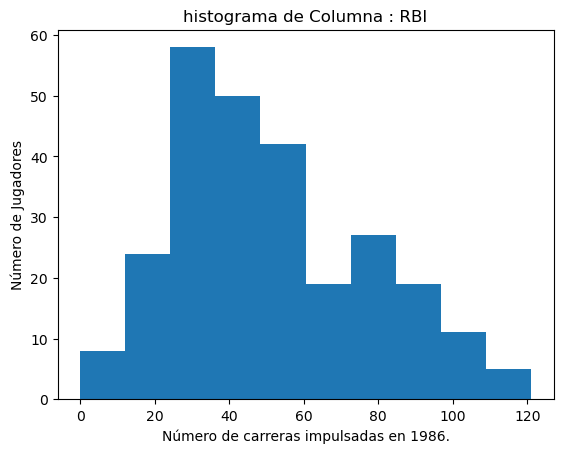

Mínimo :  0
Máximo :  105


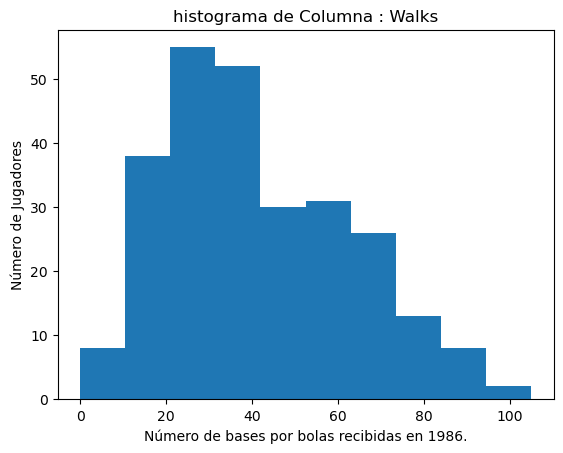

Mínimo :  1
Máximo :  24


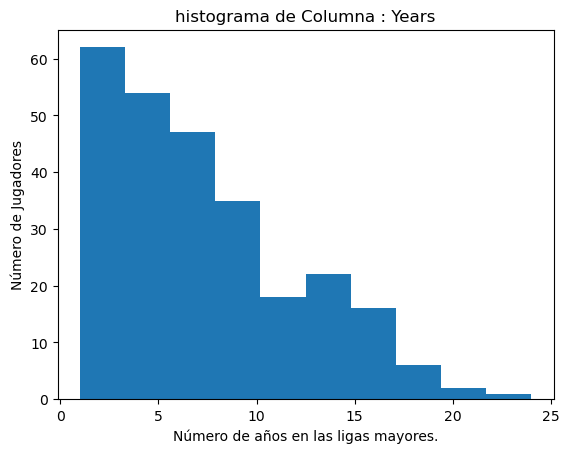

Mínimo :  19
Máximo :  14053


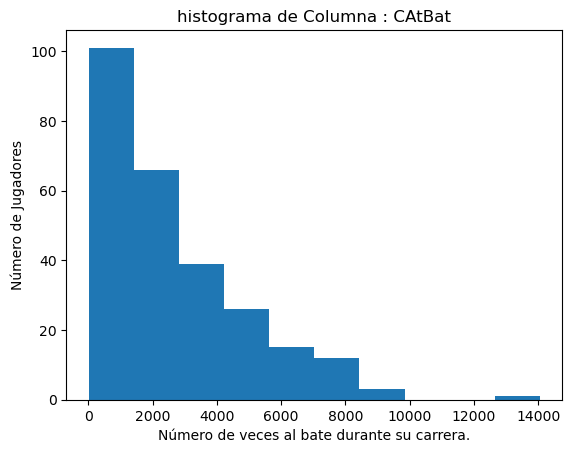

Mínimo :  4
Máximo :  4256


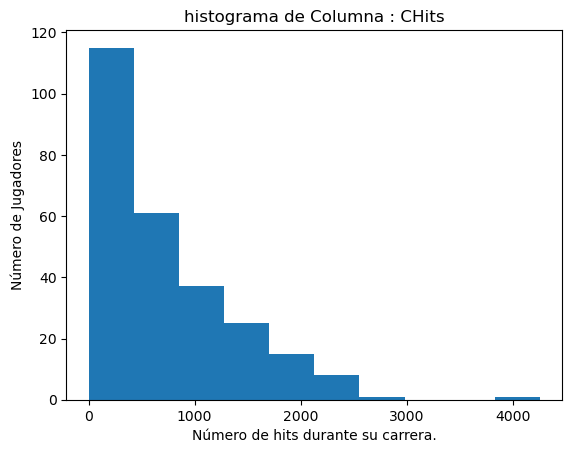

Mínimo :  0
Máximo :  548


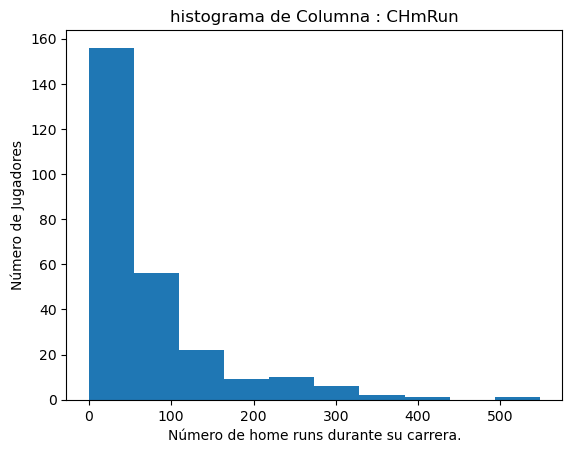

Mínimo :  2
Máximo :  2165


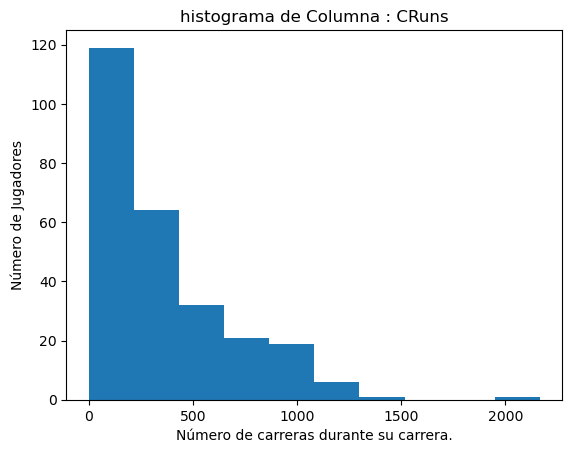

Mínimo :  3
Máximo :  1659


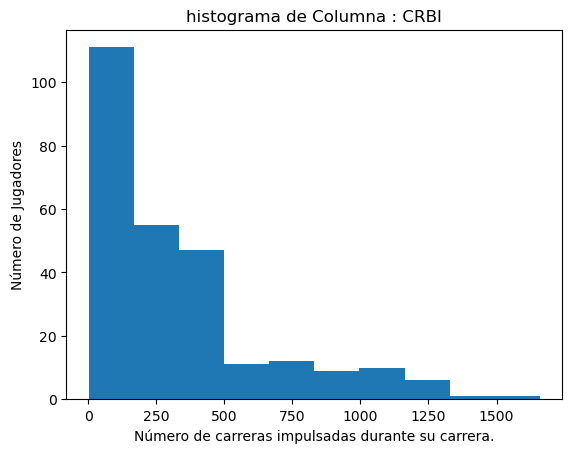

Mínimo :  1
Máximo :  1566


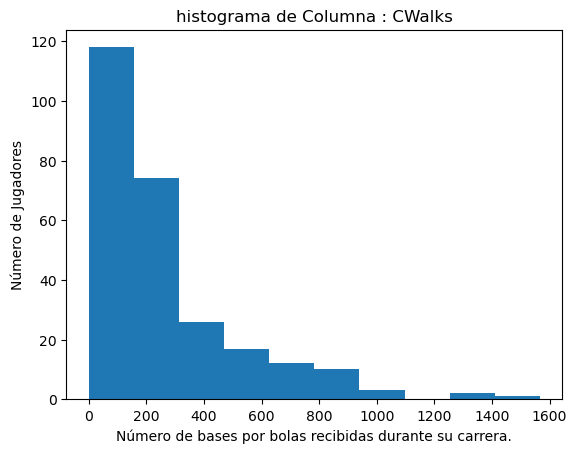

Mínimo :  0
Máximo :  1377


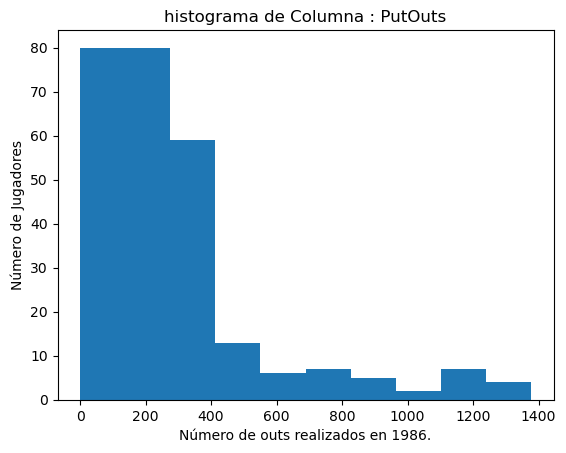

Mínimo :  0
Máximo :  492


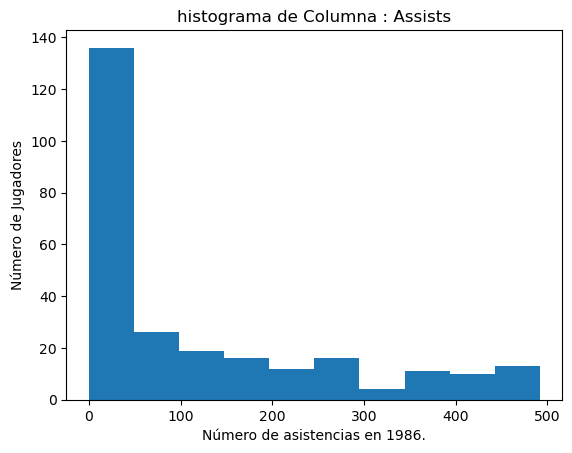

Mínimo :  0
Máximo :  32


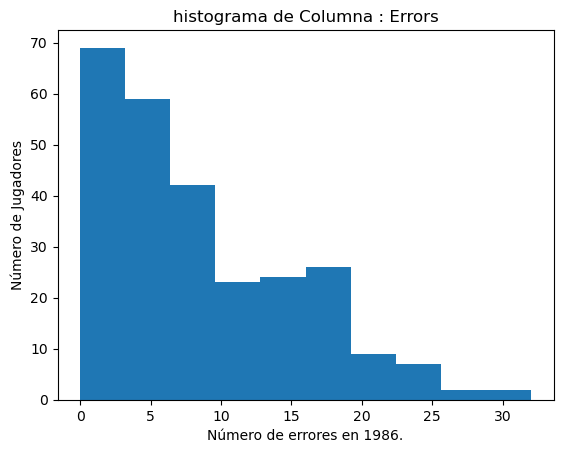

Mínimo :  0
Máximo :  1


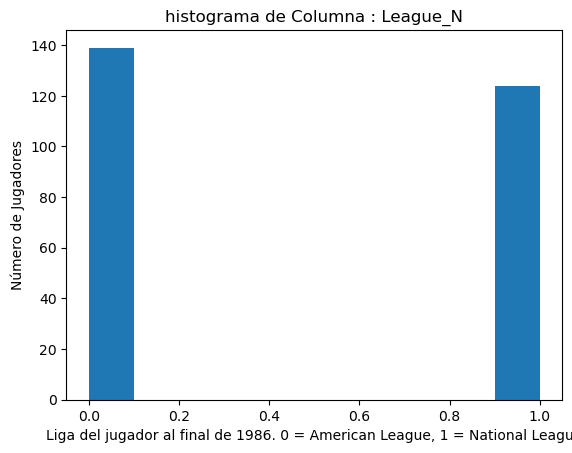

Mínimo :  0
Máximo :  1


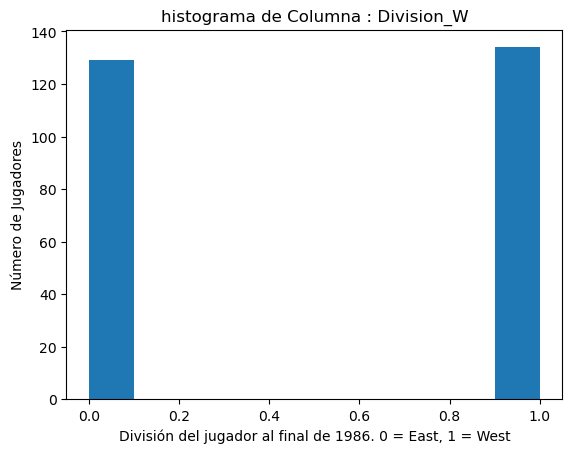

Mínimo :  0
Máximo :  1


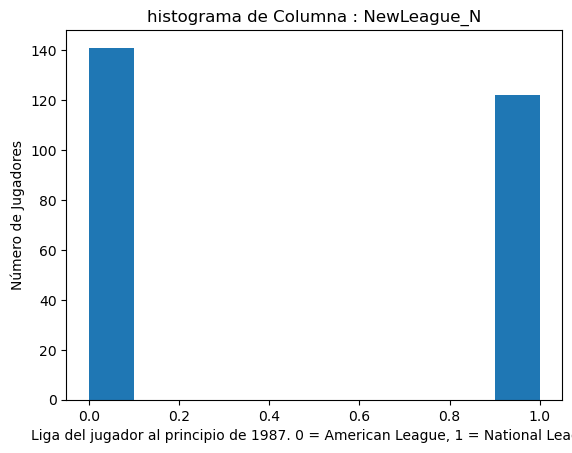

In [25]:
#Histograma de cada columnas.

for columna in X.columns.to_list():
    print('Mínimo : ', X[columna].min() )
    print('Máximo : ', X[columna].max() )
    plt.hist( X[columna] )
    plt.title(f'histograma de Columna : {columna}' )
    plt.xlabel(descrip[columna])
    plt.ylabel('Número de Jugadores')
    plt.show()


Primedio :  403.6425855513308


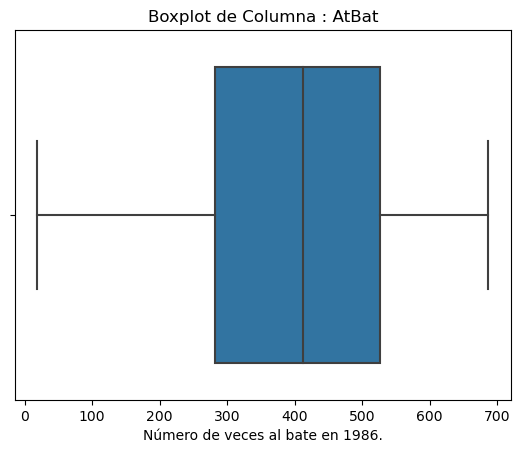

Primedio :  107.82889733840304


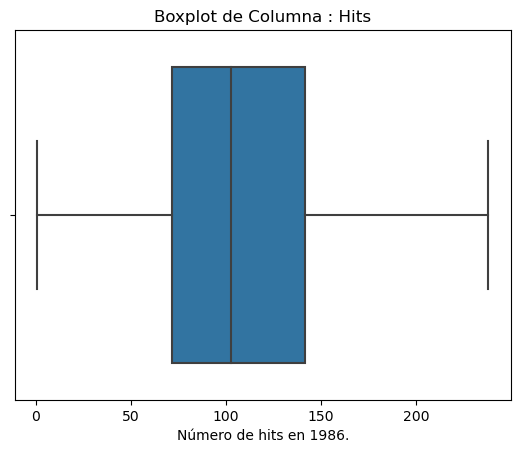

Primedio :  11.61977186311787


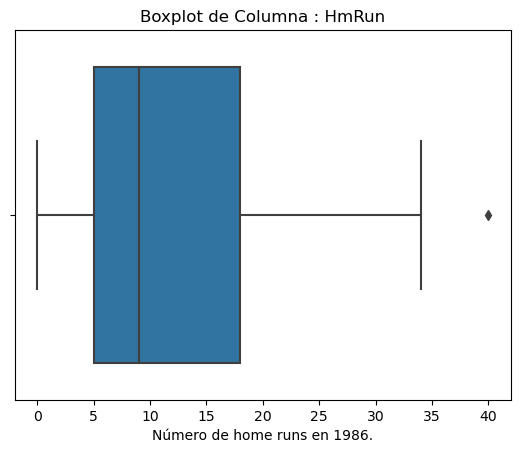

Primedio :  54.745247148288975


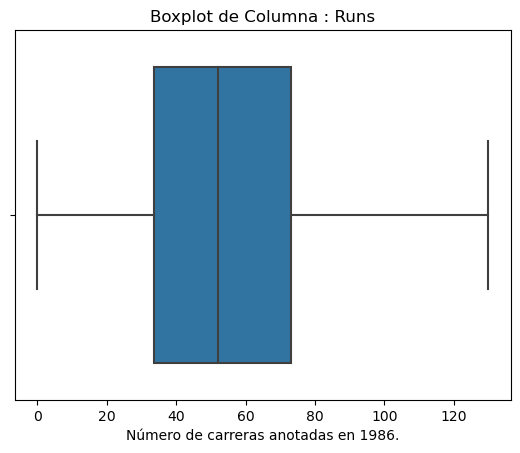

Primedio :  51.48669201520912


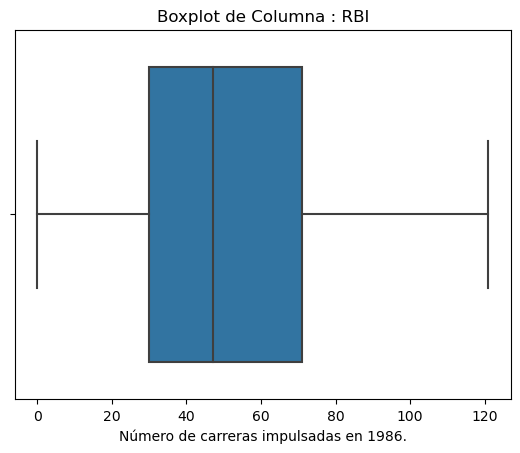

Primedio :  41.11406844106464


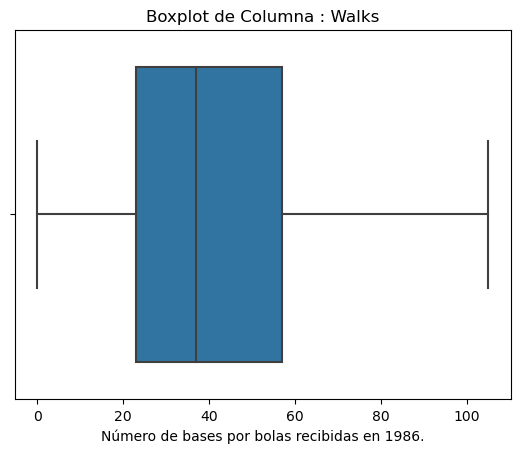

Primedio :  7.311787072243346


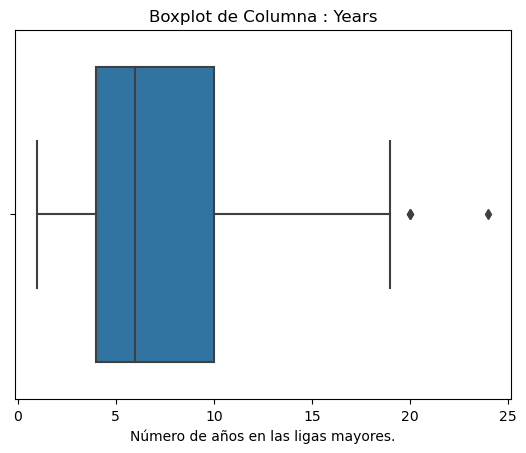

Primedio :  2657.5437262357414


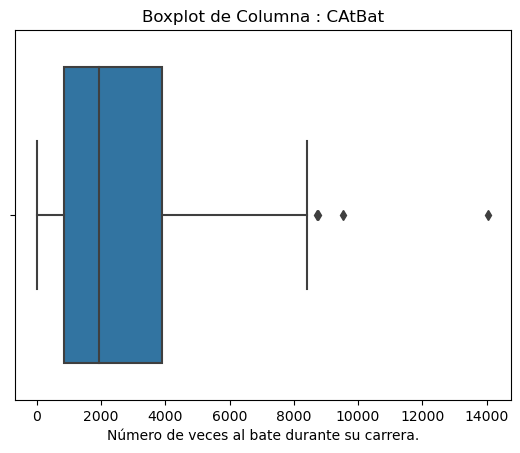

Primedio :  722.1863117870722


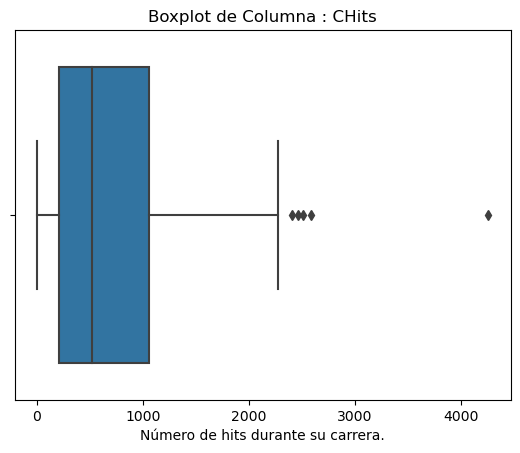

Primedio :  69.23954372623574


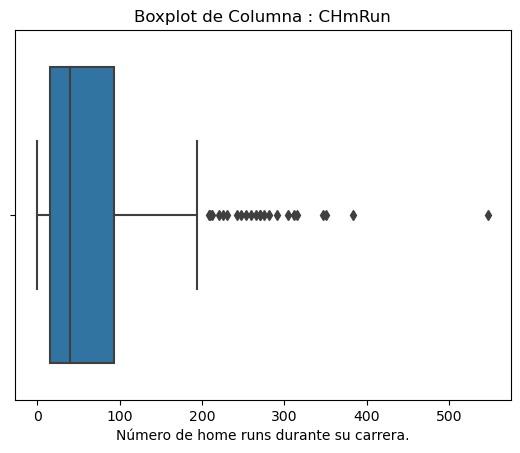

Primedio :  361.2205323193916


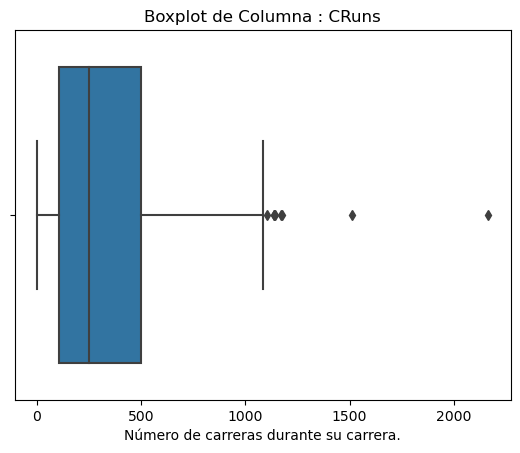

Primedio :  330.4182509505703


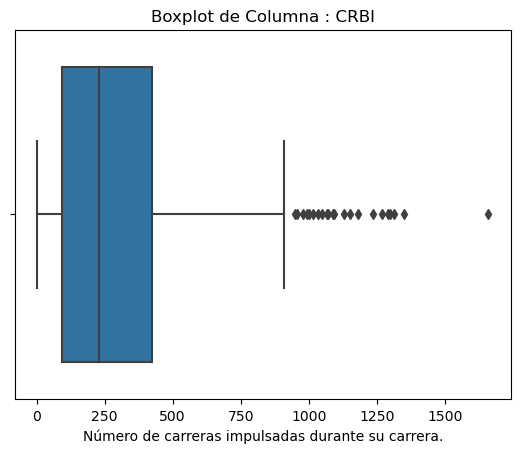

Primedio :  260.26615969581746


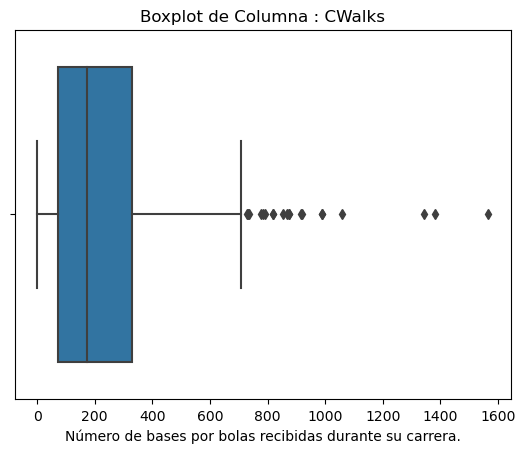

Primedio :  290.71102661596956


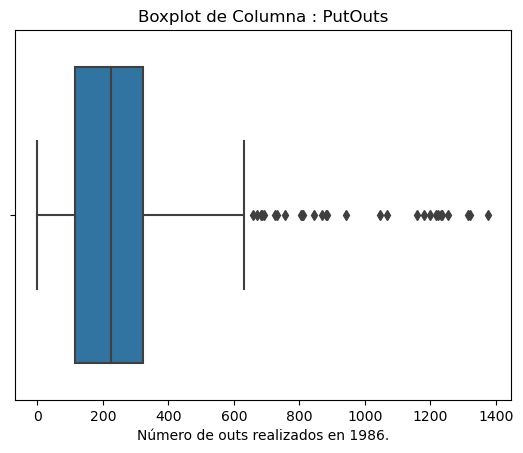

Primedio :  118.76045627376426


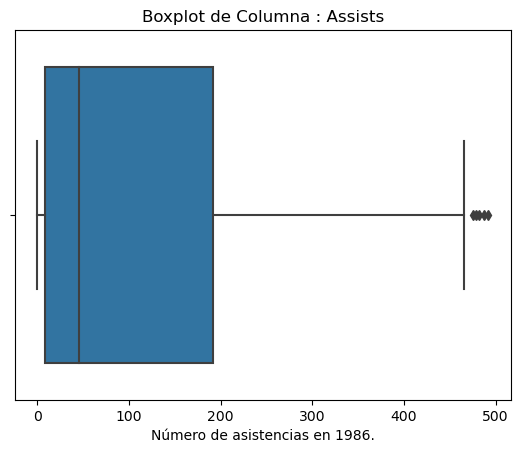

Primedio :  8.593155893536121


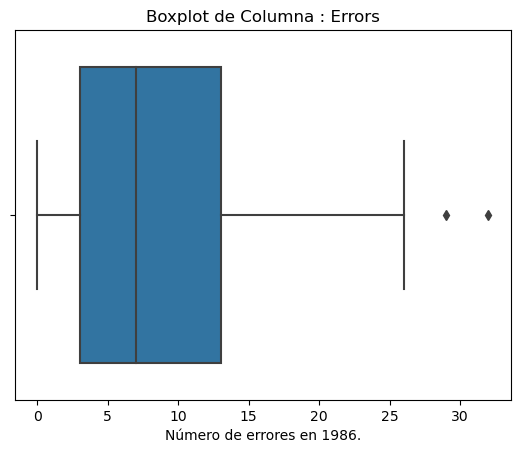

Primedio :  0.4714828897338403


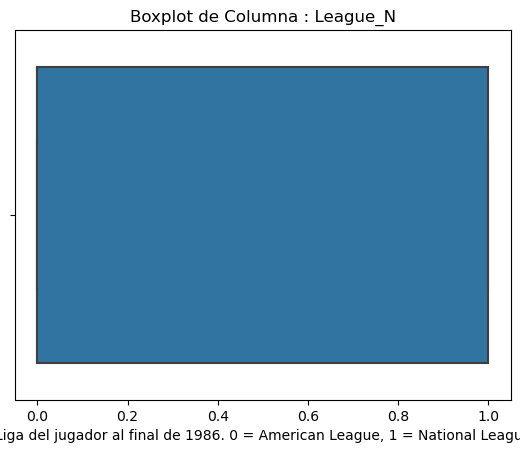

Primedio :  0.5095057034220533


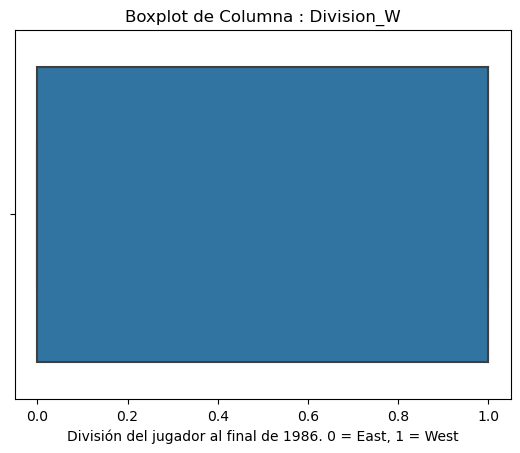

Primedio :  0.46387832699619774


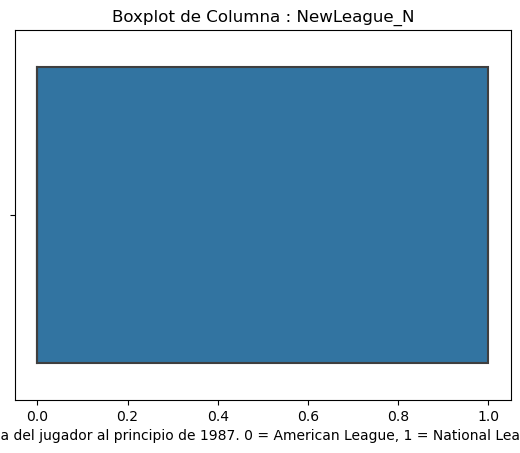

In [26]:
#Histograma de cada columnas.

for columna in X.columns.to_list():
    print('Primedio : ', X[columna].mean() )
    sns.boxplot( x = columna, data = X )
    plt.title(f'Boxplot de Columna : {columna}' )
    plt.xlabel(descrip[columna])
    plt.show()

D:\Programas\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Programas\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Programas\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Programas\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead

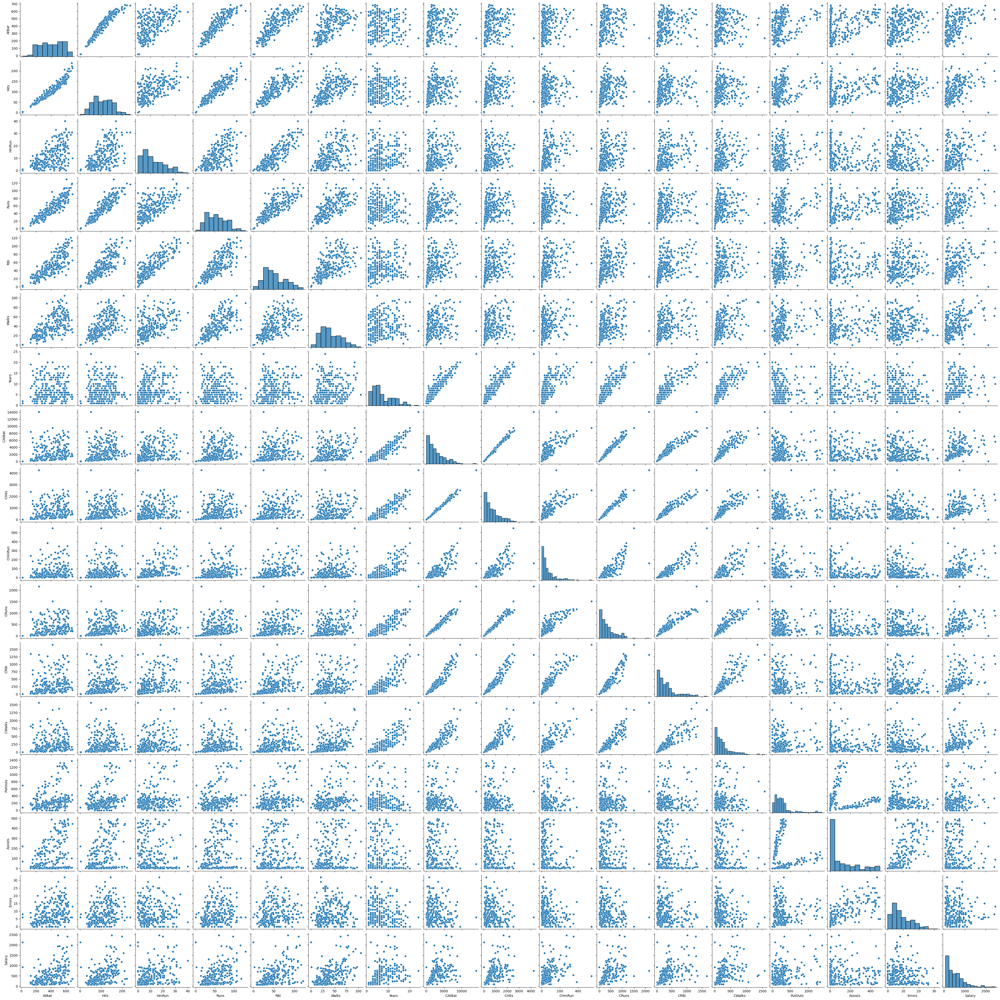

In [27]:
#CORRELACION ENTRE VARAIABLES
sns.pairplot(df)


D:\Programas\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Programas\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Programas\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Programas\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead

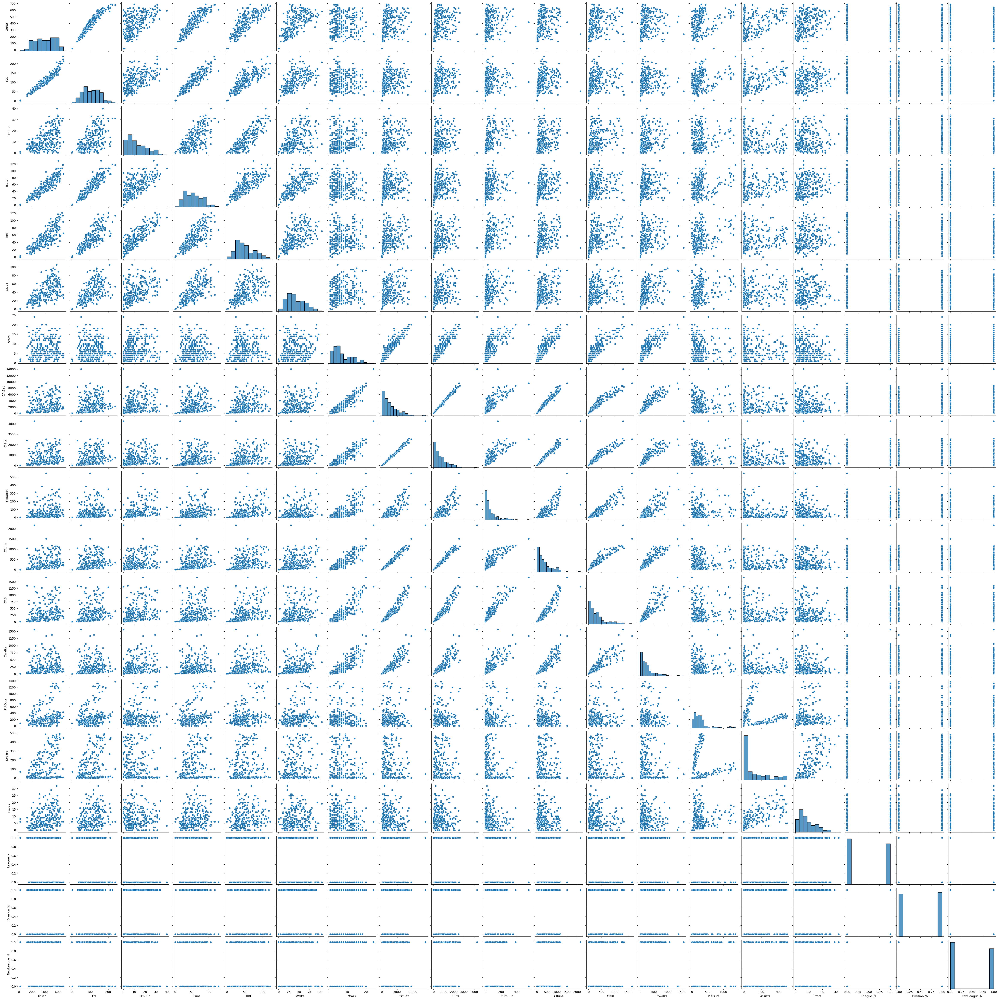

In [28]:
#CORRELACION ENTRE VARAIABLES
sns.pairplot(X)

In [29]:
X

,AtBat,Hits,HmRun,Runs,RBI,Walks,Years,CAtBat,CHits,CHmRun,CRuns,CRBI,CWalks,PutOuts,Assists,Errors,League_N,Division_W,NewLeague_N
1,315,81,7,24,38,39,14,3449,835,69,321,414,375,632,43,10,1,1,1
2,479,130,18,66,72,76,3,1624,457,63,224,266,263,880,82,14,0,1,0
3,496,141,20,65,78,37,11,5628,1575,225,828,838,354,200,11,3,1,0,1
4,321,87,10,39,42,30,2,396,101,12,48,46,33,805,40,4,1,0,1
5,594,169,4,74,51,35,11,4408,1133,19,501,336,194,282,421,25,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
317,497,127,7,65,48,37,5,2703,806,32,379,311,138,325,9,3,1,0,1
318,492,136,5,76,50,94,12,5511,1511,39,897,451,875,313,381,20,0,0,0
319,475,126,3,61,43,52,6,1700,433,7,217,93,146,37,113,7,0,1,0
320,573,144,9,85,60,78,8,3198,857,97,470,420,332,1314,131,12,0,0,0


In [30]:
columnas_no_dummies = ['AtBat',
 'Hits',
 'HmRun',
 'Runs',
 'RBI',
 'Walks',
 'Years',
 'CAtBat',
 'CHits',
 'CHmRun',
 'CRuns',
 'CRBI',
 'CWalks',
 'PutOuts',
 'Assists',
 'Errors']

C:\Users\victo\AppData\Local\Temp\ipykernel_3164\3613100675.py:6: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,4,i+1)
C:\Users\victo\AppData\Local\Temp\ipykernel_3164\3613100675.py:6: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,4,i+1)
C:\Users\victo\AppData\Local\Temp\ipykernel_3164\3613100675.py:6: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,4,i+1)
C:\Users\victo\AppData\Local\Temp\ipykernel_3164\3613100675.py:6: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax

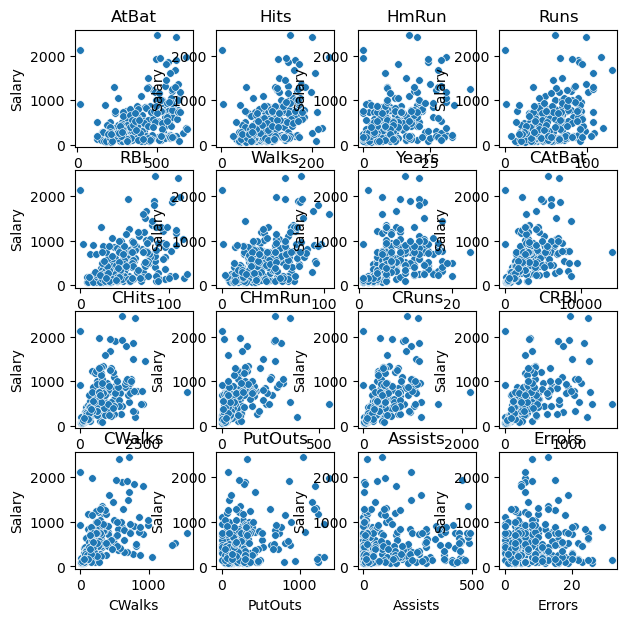

In [31]:
fig, ax = plt.subplots(figsize=(7, 7),nrows = 5, ncols=4)  # Ajusta el tamaño de la figura según tus necesidades

# Itera sobre las columnas en grupos de cuatro

for i, columna in enumerate(columnas_no_dummies):
    plt.subplot(4,4,i+1)
    #sns.pairplot(data=df, y_vars=['Salary'], x_vars=[columna], diag_kind='kde', ax=posicion)
    sns.scatterplot(data=df, x=columna, y='Salary',s= 30)
    
    plt.title(columna)  # Agrega el título con el nombre de la columna


In [32]:
X.shape

(263, 19)

In [33]:
print( np.linspace(10,-2,100)[:10])
lambdas = 10**np.linspace(10,-2,100)*0.5
print(lambdas[:10])
print( lambdas[-10:])

[10.          9.87878788  9.75757576  9.63636364  9.51515152  9.39393939
  9.27272727  9.15151515  9.03030303  8.90909091]
[5.00000000e+09 3.78231664e+09 2.86118383e+09 2.16438064e+09
 1.63727458e+09 1.23853818e+09 9.36908711e+08 7.08737081e+08
 5.36133611e+08 4.05565415e+08]
[0.06164234 0.04663017 0.03527401 0.0266835  0.02018509 0.01526928
 0.01155065 0.00873764 0.00660971 0.005     ]


In [34]:
#DIVIDIR LOS DATOS 
# 80% y 20%
#
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size= 0.2, random_state=1)

In [35]:
lambdas

array([5.00000000e+09, 3.78231664e+09, 2.86118383e+09, 2.16438064e+09,
       1.63727458e+09, 1.23853818e+09, 9.36908711e+08, 7.08737081e+08,
       5.36133611e+08, 4.05565415e+08, 3.06795364e+08, 2.32079442e+08,
       1.75559587e+08, 1.32804389e+08, 1.00461650e+08, 7.59955541e+07,
       5.74878498e+07, 4.34874501e+07, 3.28966612e+07, 2.48851178e+07,
       1.88246790e+07, 1.42401793e+07, 1.07721735e+07, 8.14875417e+06,
       6.16423370e+06, 4.66301673e+06, 3.52740116e+06, 2.66834962e+06,
       2.01850863e+06, 1.52692775e+06, 1.15506485e+06, 8.73764200e+05,
       6.60970574e+05, 5.00000000e+05, 3.78231664e+05, 2.86118383e+05,
       2.16438064e+05, 1.63727458e+05, 1.23853818e+05, 9.36908711e+04,
       7.08737081e+04, 5.36133611e+04, 4.05565415e+04, 3.06795364e+04,
       2.32079442e+04, 1.75559587e+04, 1.32804389e+04, 1.00461650e+04,
       7.59955541e+03, 5.74878498e+03, 4.34874501e+03, 3.28966612e+03,
       2.48851178e+03, 1.88246790e+03, 1.42401793e+03, 1.07721735e+03,
      

In [36]:
#
#  RIDGE REGRESSION con CV
#
# Definiendo el algoritmo con normalizsción de datos

coefs = []
dic_lmabda_error = {}
ridge = Ridge()
scaler = StandardScaler()

for k in lambdas:
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    ridge = Ridge(alpha=k)
    ridge.fit(X_train_scaled,y_train)
    coefs.append(ridge.coef_)
    Y_pred = ridge.predict(X_test_scaled)
    dic_lmabda_error[k] = mean_squared_error(y_test, Y_pred)
    print(f'Lambda : {k : 0.4f} con ERROR : {round(mean_squared_error(y_test, Y_pred),3)}')

coefs[0]
print (dic_lmabda_error)

Lambda :  5000000000.0000 con ERROR : 229163.214
Lambda :  3782316637.7731 con ERROR : 229163.197
Lambda :  2861183829.6751 con ERROR : 229163.176
Lambda :  2164380640.5415 con ERROR : 229163.148
Lambda :  1637274581.4389 con ERROR : 229163.11
Lambda :  1238538177.9959 con ERROR : 229163.061
Lambda :  936908711.4302 con ERROR : 229162.995
Lambda :  708737081.4634 con ERROR : 229162.909
Lambda :  536133611.0052 con ERROR : 229162.794
Lambda :  405565415.3948 con ERROR : 229162.643
Lambda :  306795363.6707 con ERROR : 229162.443
Lambda :  232079441.6806 con ERROR : 229162.178
Lambda :  175559586.7108 con ERROR : 229161.829
Lambda :  132804389.1473 con ERROR : 229161.367
Lambda :  100461650.1283 con ERROR : 229160.756
Lambda :  75995554.1476 con ERROR : 229159.949
Lambda :  57487849.7699 con ERROR : 229158.882
Lambda :  43487450.1309 con ERROR : 229157.471
Lambda :  32896661.2329 con ERROR : 229155.606
Lambda :  24885117.8217 con ERROR : 229153.141
Lambda :  18824679.0340 con ERROR : 2291

In [38]:
paracorre = pd.DataFrame( X_train_scaled, columns = X_train.columns)

In [43]:
paracorre

,AtBat,Hits,HmRun,Runs,RBI,Walks,Years,CAtBat,CHits,CHmRun,CRuns,CRBI,CWalks,PutOuts,Assists,Errors,League_N,Division_W,NewLeague_N,Salary
0,0.827617,0.276530,2.116246,0.016439,1.488540,0.088401,-0.318554,-0.415630,-0.493814,0.347516,-0.490822,-0.194022,-0.424838,3.309912,-0.087798,1.530217,-1.0,0.990521,-0.962604,NaN
1,-0.816649,-0.830667,-0.754012,-0.454327,-0.336939,0.887817,-0.318554,-0.755346,-0.756370,-0.667920,-0.716215,-0.715031,-0.361814,-0.381505,-0.769607,-0.956016,1.0,-1.009570,1.038849,475.0
2,0.550104,0.253935,0.561523,0.251823,0.456748,1.465172,-0.318554,-0.340712,-0.377625,-0.051405,-0.378126,-0.269751,-0.109718,0.797649,-0.396406,-0.800626,1.0,0.990521,1.038849,480.0
3,-1.114975,-1.124414,-0.275636,-0.768171,-1.090941,0.177225,0.920267,0.727519,0.714853,1.483838,0.986093,1.105471,1.317589,1.165042,-0.539945,-0.800626,1.0,-1.009570,1.038849,500.0
4,-1.385551,-1.305181,-0.156042,-1.278168,-0.852835,-0.755427,-0.318554,-0.679997,-0.729209,-0.353618,-0.713249,-0.609012,-0.606495,0.031374,-0.697838,-0.489847,-1.0,0.990521,-0.962604,91.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
205,-1.017846,-0.649900,-0.754012,-0.728941,-0.455992,-1.243958,-0.318554,-0.776444,-0.762406,-0.716274,-0.793323,-0.739264,-0.702885,-0.860864,-0.791138,-1.111405,-1.0,-1.009570,-0.962604,90.0
206,1.299389,2.310159,-0.395230,2.095658,0.813906,2.841944,-0.525024,0.026990,0.360250,-0.474504,0.309915,-0.054683,0.546472,-0.591443,1.125105,1.685607,-1.0,-1.009570,-0.962604,NaN
207,-0.074301,0.321722,0.202740,0.016439,0.298010,-0.222483,0.920267,-0.250724,-0.219185,-0.365707,-0.244670,-0.139498,-0.157913,-0.808380,0.328465,0.131711,1.0,0.990521,1.038849,NaN
208,-0.899903,-0.785476,-1.232389,-1.082016,-1.090941,-0.488955,-0.731494,-0.786777,-0.783531,-0.752540,-0.849671,-0.781672,-0.680641,-0.731402,0.263872,-0.645237,1.0,-1.009570,1.038849,NaN


In [41]:
y_train

272     100.0
262     191.0
23      600.0
142    1300.0
297     245.0
        ...  
255     250.0
313    1600.0
95      595.0
289     250.0
50      875.0
Name: Salary, Length: 210, dtype: float64

Text(0, 0.5, 'beta')

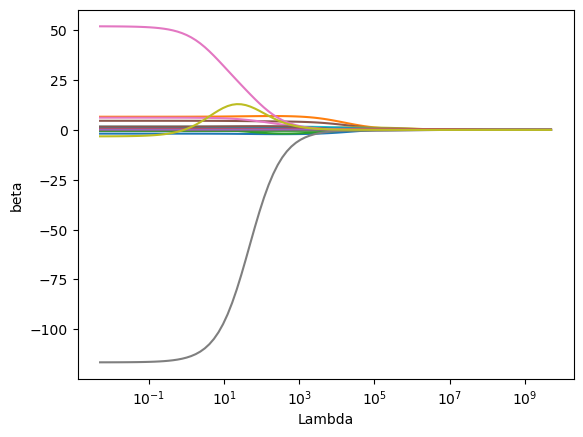

In [281]:
#Graficando coeficiente
ax = plt.gca()
ax.plot(lambdas,coefs)
ax.set_xscale('log')
plt.axis('tight')
plt.xlabel('Lambda')
plt.ylabel('beta')


In [315]:
#
#  Lambda = 5
#
k = 5

# Normalizar los datos de entrenamiento y prueba
#Viene normalizado por defecto
#scaler = StandardScaler()


#X_train_scaled = scaler.fit_transform(X_train)
#X_test_scaled  = scaler.transform(X_test)

# Definir el modelo Ridge con el valor de alpha
mod_ridge5 = Ridge(alpha=k)

#Entrenando modelo : 
mod_ridge5.fit(X_train_scaled, y_train)

# Obtener los coeficientes del modelo y mostrarlos
coefs_ridge5 = pd.Series(mod_ridge5.coef_, index=X.columns)
print(coefs_ridge5)



AtBat         -187.010966
Hits           199.801664
HmRun          -26.031403
Runs            23.087750
RBI             26.737570
Walks           82.184679
Years          -37.340902
CAtBat         -88.800414
CHits          110.096852
CHmRun          93.753191
CRuns          127.185584
CRBI            92.637717
CWalks         -96.706050
PutOuts         84.011115
Assists         -2.195456
Errors           9.494307
League_N        18.125353
Division_W     -59.472559
NewLeague_N      3.868331
dtype: float64


<BarContainer object of 19 artists>

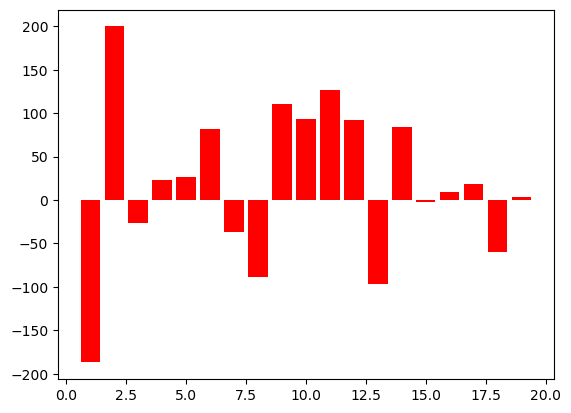

In [316]:
#Graficando

eje_X = range(1,len(mod_ridge5.coef_)+1,1)
plt.bar(eje_X, mod_ridge5.coef_,color='red')

In [317]:
#
# PREDICCIONES
#
Y_pred = mod_ridge5.predict(X_test_scaled)

Text(0, 0.5, 'Salario Estimado')

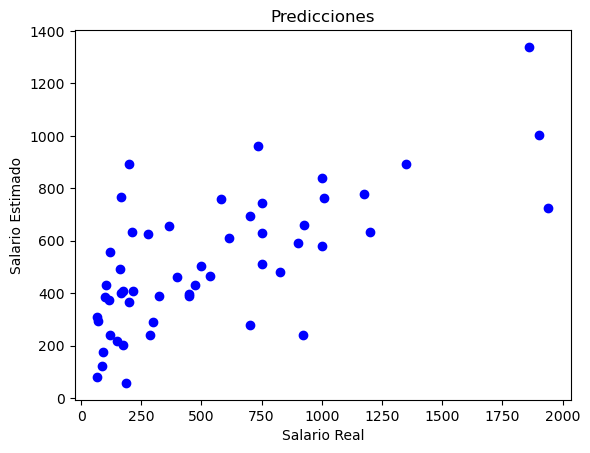

In [320]:
#
#  GRAFIAMOS AMBOS
#
plt.scatter(y_test,Y_pred,color = 'blue')
plt.title('Predicciones')
plt.xlabel('Salario Real')
plt.ylabel('Salario Estimado')

#Graficando contra el salario real, no contra alguna 
#variable predictora.
#

In [321]:
EMC5 = round(mean_squared_error(y_test, Y_pred),3)
EMC5

126777.663

In [322]:
#
#  Lambda = 0
#
# Antiguo mod_ridge0 = Ridge(alpha = 5, normalize = True)
# Nuevo : 
k = 0

mod_ridge0 = Ridge(alpha=k)
# Normalizar los datos de entrenamiento y prueba
#Viene normalizado por defecto

#Entrenando modelo : 
mod_ridge0.fit(X_train_scaled, y_train)

# Obtener los coeficientes del modelo y mostrarlos
coefs_ridge0 = pd.Series(mod_ridge0.coef_, index=X.columns)
print(coefs_ridge0)

AtBat         -270.483118
Hits           291.624658
HmRun            2.128978
Runs           -11.362077
RBI              0.980147
Walks          102.738929
Years           29.768600
CAtBat        -827.680284
CHits          655.872152
CHmRun         131.557332
CRuns          258.220521
CRBI            88.268033
CWalks        -120.154785
PutOuts         82.063038
Assists         19.866540
Errors          10.650210
League_N        25.978663
Division_W     -58.284988
NewLeague_N     -1.628345
dtype: float64


Text(0, 0.5, 'Salario Estimado')

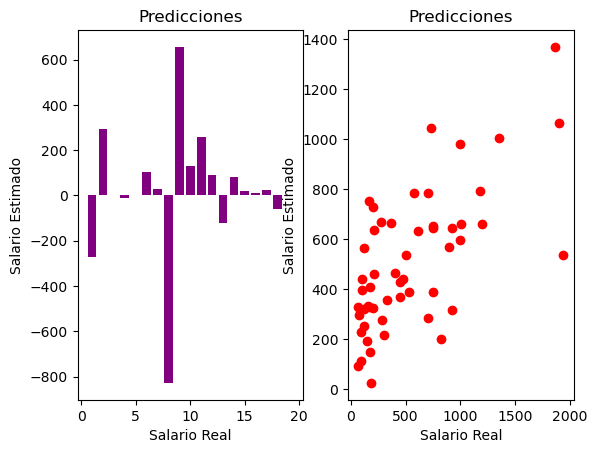

In [348]:
#Graficando

eje_X = range(1,len(mod_ridge0.coef_)+1,1)
plt.subplot(1,2,1)
plt.bar(eje_X, mod_ridge0.coef_,color='purple')
plt.title('Predicciones')
plt.xlabel('Salario Real')
plt.ylabel('Salario Estimado')

plt.subplot(1,2,2)
plt.scatter(y_test,Y_pred,color = 'red')
plt.title('Predicciones')
plt.xlabel('Salario Real')
plt.ylabel('Salario Estimado')

In [324]:
#
# PREDICCIONES
#
Y_pred = mod_ridge0.predict(X_test_scaled)

Text(0, 0.5, 'Salario Estimado')

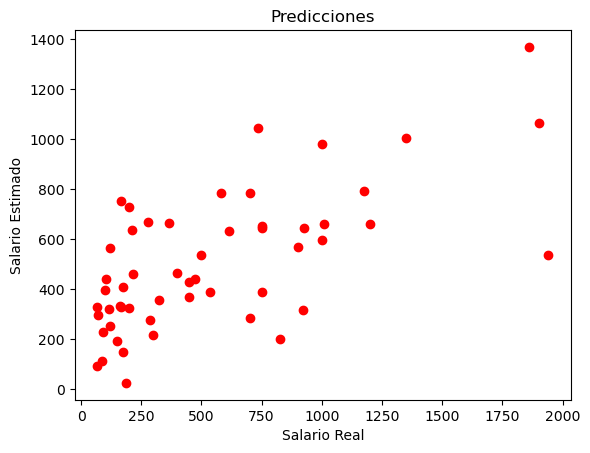

In [344]:
#
#  GRAFIAMOS AMBOS
#
plt.scatter(y_test,Y_pred,color = 'red')
plt.title('Predicciones')
plt.xlabel('Salario Real')
plt.ylabel('Salario Estimado')

#Graficando contra el salario real, no contra alguna 
#variable predictora.
#

In [345]:
EMC5 = round(mean_squared_error(y_test, Y_pred),3)
EMC5

133406.545

In [327]:
#
#  Modelo Ridge con CrossValidaction
#

In [366]:

mod_ridgecv = RidgeCV(alphas=lambdas, scoring ='neg_mean_squared_error')
mod_ridgecv.fit(X_train_scaled, y_train)

print(f'Mejor Lambda : {mod_ridgecv.alpha_: 0.4f}')




Mejor Lambda :  2.3208


In [367]:
# Verificar laexistencia del lambda calculado en lambdas
if mod_ridgecv.alpha_ in lambdas:
    print(f'Mejor Lambda : {mod_ridgecv.alpha_ : 0.4f}')

Mejor Lambda :  2.3208


In [368]:
#
#  Lambda = 0
#
# Antiguo mod_ridge0 = Ridge(alpha = 5, normalize = True)
# Nuevo : 
k = mod_ridgecv.alpha_

mod_ridge0cv = Ridge(alpha=k)
# Normalizar los datos de entrenamiento y prueba
#Viene normalizado por defecto

#Entrenando modelo : 
mod_ridgecv.fit(X_train_scaled, y_train)

# Obtener los coeficientes del modelo y mostrarlos
coefs_ridge0 = pd.Series(mod_ridge0.coef_, index=X.columns)
print(coefs_ridge0)


#
# PREDICCIONES
#
Y_pred = mod_ridgecv.predict(X_test_scaled)
EMCCV = round(mean_squared_error(y_test, Y_pred),3)
EMCCV

AtBat         -270.483118
Hits           291.624658
HmRun            2.128978
Runs           -11.362077
RBI              0.980147
Walks          102.738929
Years           29.768600
CAtBat        -827.680284
CHits          655.872152
CHmRun         131.557332
CRuns          258.220521
CRBI            88.268033
CWalks        -120.154785
PutOuts         82.063038
Assists         19.866540
Errors          10.650210
League_N        25.978663
Division_W     -58.284988
NewLeague_N     -1.628345
dtype: float64


126176.889

In [369]:
print('Modelo con Lmabda 5 : ', EMC5)
#print('Modelo con Lmabda 5 : ', EMC0)
print('Modelo con Lmabda 5 : ', EMCCV)

Modelo con Lmabda 5 :  133406.545
Modelo con Lmabda 5 :  126176.889


In [376]:
#Evaluando el modelo selccionado por mejorpuntje
# Calcula R**2 ajustada
r_2 = r2_score(y_test,Y_pred)
print('R2 = ', round(r_2,3))

#r2 ajustada
n = len(y_train)
p = X_train.shape[1]
r_cuad_aju = 1 - ( (   (1-r_2)*(n-1) )/(n-p-1))

print('valor n : ',n)
print('valor p : ',p)
print('Valor r**2 ajustada : ', r_cuad_aju)


R2 =  0.449
valor n :  210
valor p :  19
Valor r**2 ajustada :  0.3939964432802656


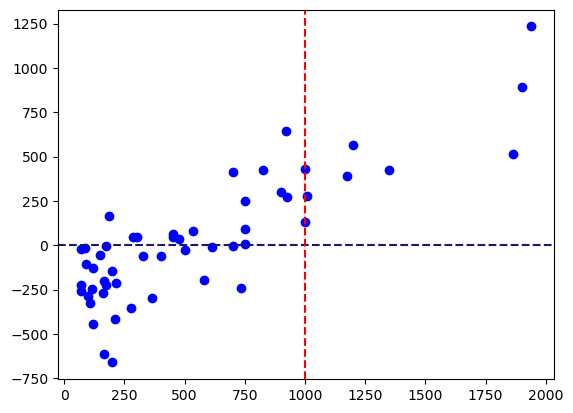

In [390]:
# Graficando eerrores absolutos
err_abs = y_test-Y_pred

plt.scatter(y_test, err_abs, color = 'blue')
plt.axhline(y=0, color='midnightblue', linestyle='--')
plt.axvline(x=1000, color='r', linestyle='--')
#plt.plot(y_test,np.zeros(len(err_abs)), color = 'midnightblue')


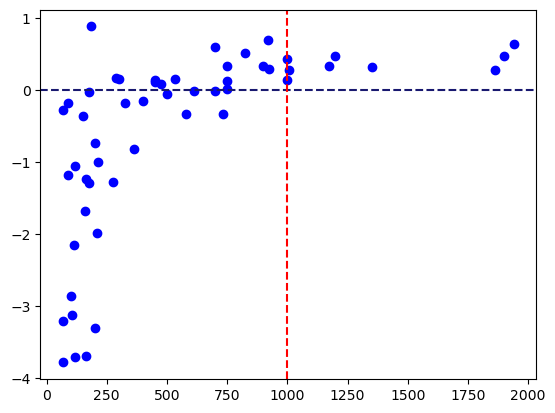

In [393]:
# Calcular los errores relativos
# ['real - estimado)(real
err_real = err_abs/y_test

plt.scatter(y_test, err_real, color = 'blue')
plt.axhline(y=0, color='midnightblue', linestyle='--')
plt.axvline(x=1000, color='r', linestyle='--')
#plt.plot(y_test,np.zeros(len(err_abs)), color = 'midnightblue')
         

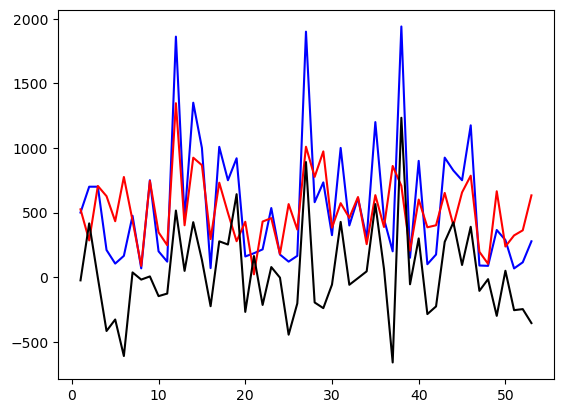

In [398]:
# Graficasmo los valores reales vs estimados

eje_X = range(1,len(y_test)+1)
plt.plot(eje_X,y_test,color = 'blue')
plt.plot(eje_X,Y_pred,color = 'red')
plt.plot(eje_X,err_abs, color  = 'black')


In [402]:
# Calcular el error cuadrático  = (real - estimado)**2

err_cuad = pow(err_abs,2)

print(f'ECM con Lambda : {mod_ridgecv.alpha_ : 0.4f} , es : {EMCCV}')

ECM con Lambda :  2.3208 , es : 126176.889


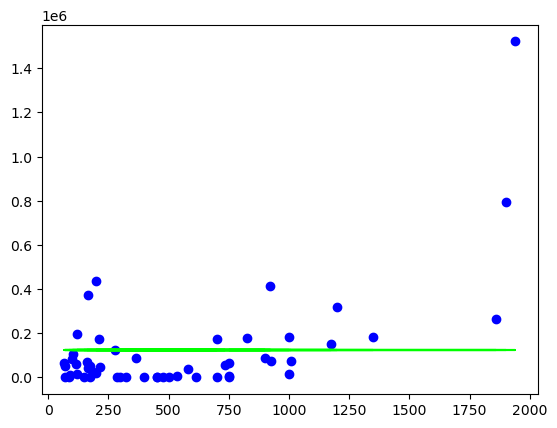

In [403]:
#graficando los errores cuadraticos

Y = np.repeat(EMCCV,len(err_cuad))
plt.scatter(y_test, err_cuad, color = 'blue')
plt.plot(y_test, Y , color = 'lime')

In [406]:
arreglo = ['h', 'm', 'h', 'h', 'm', 'h', 'm', 'm']

In [408]:
np.recode(array == 'h', 1, 0)

AttributeError: module 'numpy' has no attribute 'recode'